<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Read-the-.fits-raw-data" data-toc-modified-id="Read-the-.fits-raw-data-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Read the <em>.fits</em> raw data</a></span></li><li><span><a href="#Preprocessing-data-analysis" data-toc-modified-id="Preprocessing-data-analysis-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Preprocessing data analysis</a></span><ul class="toc-item"><li><span><a href="#Time-sample-analysis" data-toc-modified-id="Time-sample-analysis-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Time sample analysis</a></span></li></ul></li></ul></div>

### Read the _.fits_ raw data

---

For reading the `.fits` data-set one may use the utils library. It will get a HUD table with 3 items, and only the last one (`index = 2`) has the proper information for experimental analysis.

In [2]:
import utils

folder_list = [ '.\\database\\raw_fits\\confirmed_targets',
                '.\\database\\raw_fits\\red_giants',
                '.\\database\\raw_fits\\bright_stars' ]

dread = utils.data_helper.reader()
curves  = dread.from_folder(folder=folder_list[0], label='confirmed targets', index=2)
#curves += dread.from_folder(folder=folder_list[1], label='red giants', index=2)
#curves += dread.from_folder(folder=folder_list[2], label='bright stars', index=2)

INFO:reader_log:Reader module created...
INFO:reader_log:Reading 37 curve packages...


<IPython.core.display.Javascript object>


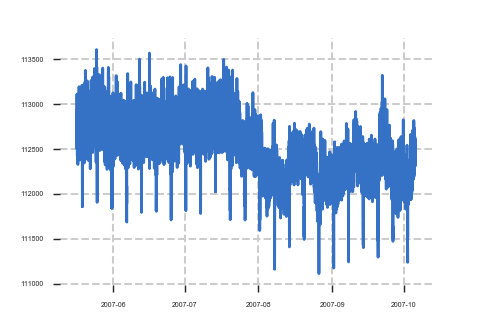

In [3]:
%matplotlib notebook

curves[0].show_feature(feature='WHITEFLUXSYS')

### Preprocessing data analysis

---

This is just a simple analysis to manipulate the sample time distributions.

#### Time sample analysis


In [50]:
import plotly.graph_objects as go

import pandas as pd
import numpy as np
from datetime import datetime

dt,dt_max,dt_min,dt_mean = [],[],[],[]
for curve in curves:
    diff_time = np.diff(curve["DATE"])
    dt.append([x.total_seconds() / 60 for x in diff_time])
    dt_mean.append(np.mean(dt[-1]))
    dt_max.append(np.percentile(dt[-1], 75))
    dt_min.append(np.percentile(dt[-1], 25))
dt_min = np.mean(dt_mean) - 1.05 * ( np.mean(dt_mean) - np.mean(dt_min) )
dt_max = np.mean(dt_mean) + 0.01 * ( np.mean(dt_mean) - np.mean(dt_max) )   
fig = go.Figure(data=[go.Box(y = value) for value in dt])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)' )
#fig.update_yaxes(range=[np.mean(dt_min), np.mean(dt_max)])
fig.update_yaxes(range=[dt_min, dt_max])
fig.show()

8.9608174075

[7.679538315,
 7.67953951875,
 7.67947254,
 7.679731425,
 7.679717535000001,
 7.67936631,
 7.67935545,
 7.679716335,
 7.680056115,
 7.679715735,
 7.680056107500001,
 7.67971755,
 7.67972238,
 7.680062145000001,
 7.67935062,
 7.6793512349999995,
 7.679349419999999,
 7.679408565,
 7.679409765,
 7.679409165,
 7.679405549999999,
 7.6800573225,
 7.679530462500001,
 7.679730210000001,
 7.679730210000001,
 7.679441145,
 7.679710305,
 7.680287865,
 7.67971695,
 7.67964573,
 7.67965479,
 7.680612525000001,
 7.679652975,
 7.68029931,
 7.6803012862500015,
 7.679415195,
 7.67940735]